# Hierarchical multi-class classification


Importing necessary libraries and utils.

In [3]:
from IPython.display import display
import pandas as pd
import numpy as np
from treelib import Node, Tree
import graphviz
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
import torch
import time

import xgboost as xgb
from lightgbm import LGBMRegressor
from rich.console import Console
from rich.progress import *
from sklearn.ensemble import *
from sklearn.metrics import *
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.neighbors import *
from xgboost import plot_importance
from xgboost import XGBRegressor
from yaml.loader import SafeLoader
from rich.console import Console
from rich.console import Console
from rich.theme import Theme
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics

custom_theme = Theme({
    "valid": "bold green encircle",
    "info": "dim cyan",
    "warning": "magenta",
    "danger": "bold red"
})
test_theme={
    True:"valid",
    False:"danger",
}
console = Console(theme=custom_theme)


pd.options.display.max_rows=50
pd.options.display.max_columns=90

Loading the data using pandas.

In [4]:
X_test_raw = pd.read_csv("data/data_test.csv")
X_train_raw =pd.read_csv("data/data_train.csv")
categories = pd.read_csv("data/category_parent.csv")
categories=categories.sort_values(by="category_id")
categories=categories.fillna(-1)
categories=categories.astype(int)

Converting the categories hierarchy into a tree structure.

In [5]:
def create_hiarchy_tree(categories_path="data/category_parent.csv", clothing_categories = None):
    categories = pd.read_csv(categories_path)
    categories=categories.sort_values(by="category_id")
    categories=categories.fillna(-1)
    categories=categories.astype(int)
    tree = Tree()
    tree.create_node(-1, -1) # root node
    if clothing_categories is None :

        for i, row in categories.iterrows():
            if i!=0:
                tree.create_node(row["category_id"],row["category_id"], parent=row["parent_id"])
        return tree
    else : 
        categories["label"]=categories["category_id"].map(clothing_categories)
        for i, row in categories.iterrows():
            if i!=0:
                tree.create_node(row["label"],row["category_id"], parent=row["parent_id"])
        return tree
    
tree = create_hiarchy_tree(categories_path="data/category_parent.csv")

Adding dummy label names for the category tree. For this usecase, we'll imagine that the categories represente clothing categories. This was useful in the readability of the outputs labels (it's much easier to know that jeans is a child category of pants, rather than 77 is child category of 66)

In [6]:
import yaml

# Path to the YAML file
file_path = 'data/category_labels.yaml'

# Load the YAML file as a dictionary
with open(file_path, 'r') as file:
    clothing_categories = yaml.safe_load(file)


Output()

In [7]:
tree = create_hiarchy_tree(categories_path="data/category_parent.csv", clothing_categories = clothing_categories)
tree.show()

-1
├── Bags
│   ├── Backpacks
│   │   ├── School Backpacks
│   │   │   └── Laptop Backpacks
│   │   └── Travel Backpacks
│   │       └── Hiking Backpacks
│   ├── Handbags
│   │   └── Tote Bags
│   │       └── Shoulder Bags
│   ├── Messenger Bags
│   │   └── Crossbody Bags
│   │       └── Satchel Bags
│   └── Wallets
│       └── Bifold Wallets
│           └── Cardholder Wallets
├── Belts
│   ├── Fabric Belts
│   │   └── Dark Fabric Belts
│   │       └── Black Fabric Belts
│   └── Leather Belts
│       └── Dark Leather Belts
│           └── Black Leather Belts
├── Blouses
│   ├── Button-Up Blouses
│   │   └── Silk Button-Up Blouses
│   │       └── Printed Silk Button-Up Blouses
│   └── Lace Blouses
│       └── Long Sleeve Lace Blouses
│           └── Off-Shoulder Long Sleeve Lace Blouses
├── Coats
│   ├── Parkas
│   │   └── Faux Fur Parkas
│   │       └── Hooded Faux Fur Parkas
│   ├── Puffer Coats
│   │   └── Long Puffer Coats
│   │       └── Hooded Long Puffer Coats
│   └── Wool Coats


It's useful to obtain the parents category of a specific category, of the parents of its parents and so on.

In [8]:
def collapse_children(tree, id, level):
    while level!=0:
        level -=1
        id = tree.parent(id).identifier
    return id
collapse_children(tree, 77, 3) 

collapse_children(tree, 77, 4) # 4 levels for this categories tree

-1

Using graphviz for better visualization

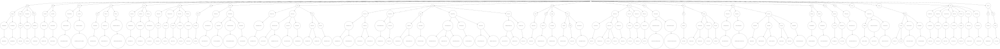

In [9]:
tree.to_graphviz("assets/categories.dot")
graph = graphviz.Source.from_file(filename="assets/categories.dot")
graph

In [10]:
from sklearn import preprocessing

label_enconders = {}
target_columns = []

# Expanding the categories by level
for level in range(tree.depth()+1) : # ! change this to tree.depth()
    # Collapsing level
    print(f"Collapsing categories - level : {level}")
    X_train_raw[f"category_id_level_{level}"] = X_train_raw[f"category_id"].apply(lambda i : collapse_children(tree, i, level)  )
    X_test_raw[f"category_id_level_{level}"] = X_test_raw[f"category_id"].apply(lambda i : collapse_children(tree, i, level)  )
    
    # Encoding the categories to match [0, n_classes-1]
    label_enconders[level]=preprocessing.LabelEncoder()
    label_enconders[level].fit(X_train_raw[f"category_id_level_{level}"].values)

    X_train_raw[f"category_id_level_{level}"] = label_enconders[level].transform((X_train_raw[f"category_id_level_{level}"].values))
    X_test_raw[f"category_id_level_{level}"] = label_enconders[level].transform((X_test_raw[f"category_id_level_{level}"].values))

Collapsing categories - level : 0
Collapsing categories - level : 1
Collapsing categories - level : 2
Collapsing categories - level : 3
Collapsing categories - level : 4


In [11]:
X_train_raw.head(4)

,product_id,category_id,f0,f1,f2,f3,f4,f5,f6,f7,f8,f9,f10,f11,f12,f13,f14,f15,f16,f17,f18,f19,f20,f21,f22,f23,f24,f25,f26,f27,f28,f29,f30,f31,f32,f33,f34,f35,f36,f37,f38,f39,f40,f41,f42,...,f88,f89,f90,f91,f92,f93,f94,f95,f96,f97,f98,f99,f100,f101,f102,f103,f104,f105,f106,f107,f108,f109,f110,f111,f112,f113,f114,f115,f116,f117,f118,f119,f120,f121,f122,f123,f124,f125,f126,f127,category_id_level_0,category_id_level_1,category_id_level_2,category_id_level_3,category_id_level_4
0,cdc53c8374034e8d41528375097a51c087390292,2081,-0.006559,-0.120659,-0.004383,0.007749,-0.037135,-0.039693,-0.000479,-0.009981,-0.035670,-0.023168,-0.014077,-0.013253,-0.045385,0.004600,-0.002582,-0.021925,0.005633,0.004472,0.011264,0.012100,-0.010383,0.019336,-0.008837,0.026796,-0.008611,0.018661,0.014207,0.016965,-0.023982,-0.019511,0.000599,-0.006063,-0.027962,0.021617,-0.007242,0.017016,0.017954,-0.007274,0.009094,-0.013713,-0.016284,0.001005,-0.010102,...,0.006231,0.005863,-0.002476,-0.008922,-0.012913,-0.008808,0.019236,0.002136,0.000903,-0.003009,0.007771,0.003619,99.981491,0.003142,-0.003385,-0.000104,-0.012340,0.000203,0.000926,0.006195,0.011299,-0.005023,-0.004069,-0.010593,-0.001224,-0.004105,0.007796,0.001508,0.002476,-0.001015,0.012074,-0.002464,-0.005398,0.002239,-0.010406,-0.008286,0.007256,0.003646,0.007139,-0.011185,9,9,9,1,0
1,7faed7269ff5e13ced9245d23e88cb17e8b4c91b,9820,0.101763,-0.018803,-0.027987,-0.043492,0.096025,0.016519,0.010036,-0.015817,-0.021493,-0.001037,-0.020642,-0.015708,-0.035804,0.003129,-0.002420,0.012331,-0.004594,0.008506,0.009787,0.069576,0.003590,-0.020067,0.001575,0.031523,-0.009534,0.009768,0.000888,-0.000275,-0.006639,0.008310,-0.005885,0.030228,-0.013604,-0.009051,-0.024184,-0.035496,-0.017179,0.017360,-0.022030,-0.023825,-0.008258,-0.006936,0.002482,...,-0.001311,-0.013990,-0.018320,0.001118,0.026192,0.025732,0.001375,-0.011835,0.019061,0.014258,0.016933,-0.007413,99.907150,-0.016040,-0.020460,-0.000311,0.014184,-0.000015,0.005234,0.028900,-0.002301,0.004170,0.004366,0.003894,0.002276,-0.001359,0.002796,-0.002647,-0.007148,0.001977,-0.001446,-0.002490,-0.006619,-0.018201,-0.025073,-0.019518,0.002237,-0.003276,-0.000349,0.008102,69,58,37,13,0
2,c307ce173cac526708f00f509d5250af69e2adcf,15651,-0.040672,-0.078895,-0.051821,-0.011871,-0.020762,0.041655,-0.059276,-0.022324,-0.030532,-0.005174,-0.051620,0.008122,-0.008760,-0.001517,-0.015328,0.070543,0.039454,-0.031497,-0.036606,0.012170,-0.023533,0.017967,-0.016051,-0.011463,0.004227,-0.013878,0.024635,0.031946,-0.031589,-0.021962,0.006694,-0.011027,0.017594,0.008049,-0.029168,-0.013615,0.031076,-0.011527,0.043362,0.009028,-0.012136,-0.000942,0.023693,...,-0.009652,-0.021084,0.001093,0.021488,-0.006622,-0.029089,-0.010656,-0.010041,-0.017352,-0.004936,0.001214,0.004498,100.255814,0.023902,0.011164,0.002246,0.004466,0.010256,0.011630,-0.008796,0.001103,0.010753,-0.001124,-0.007801,0.019896,-0.016643,0.023458,0.021310,-0.008206,-0.022253,0.005634,-0.000398,0.003627,0.019286,0.005602,-0.009435,0.003241,-0.014601,-0.019980,0.015251,95,80,52,20,0
3,49b52f955911fafc4ddc136debb974070568551d,3056,-0.105920,0.043751,0.004357,0.085637,0.011778,-0.019016,-0.083128,0.025109,0.037442,0.035368,-0.048871,0.038032,0.070251,-0.009114,-0.006472,-0.049914,-0.008370,0.028539,-0.032045,-0.019499,0.018048,-0.057893,0.034094,-0.007274,-0.003192,-0.016082,0.012990,0.009843,-0.015644,-0.002884,0.004759,0.000811,0.003790,-0.005360,0.009386,-0.015749,0.004368,-0.004915,-0.001562,0.018099,-0.010557,-0.002454,0.017998,...,0.016095,0.006626,0.012724,0.016964,0.021050,-0.002215,-0.003918,-0.011692,-0.001084,-0.002923,0.015582,0.011139,100.105896,-0.008337,0.000842,0.009995,-0.020240,-0.002496,0.009004,-0.010974,0.003949,0.001207,0.012982,0.009529,0.004892,-0.012987,0.008997,0.020556,-0.003087,0.000559,-0.020314,0.001298,0.012358,-0.006352,0.000958,-0.006532,-0.007828,-0.016894,0.004076,0.001585,32,24,16,3,0



Problem : All our target labels are label encoded before training. In order to transition from one hieararchy level to another, we need to decode the predicted labels, and then find their parents at the specified level and then encode them again. We can directly use encoder.inverse_transform(), but during DLL training this might not be an adequate solution.

Solution : 
We'll create an adjacency matrix $A$ between $level_i$ and $level_{i+1}$. A is of dimension $(n, m)$ where $n$ is the number of classes at $level_i$  and $m* is the number of classes at $level_{i+1}$. $(a_{ij})=1$ if $j$ is parent of $i$.

This way for a vector $b = (0, ...1, ...)$  representing class $k$ at $level_0$ : $b\cdot A$ is representing the parent class of $k$ at $level_1$ .

In [21]:

def create_adjacency_matrix(labels_level_i, labels_level_i_plus, level_i, label_enconders, tree):
    labels_i = sorted(list(set(labels_level_i)))
    labels_i_plus=sorted(list(set(labels_level_i_plus)))
    adjacency_matrix = np.zeros((len(labels_i), len(labels_i_plus)))

    for i in labels_i:
        for i_plus in labels_i_plus:
            i_decoded= label_enconders[level_i].inverse_transform([i])[0]
            i_plus_decoded = label_enconders[level_i+1].inverse_transform([i_plus])[0]
            parent_label = tree.parent(i_decoded).identifier
            if parent_label == i_plus_decoded:
                adjacency_matrix[i, i_plus] = 1
    
    return adjacency_matrix

In [22]:
A = create_adjacency_matrix(X_train_raw[f"category_id_level_{0}"].values, X_train_raw[f"category_id_level_{1}"], level_i=0, label_enconders=label_enconders, tree=tree) 
B = create_adjacency_matrix(X_train_raw[f"category_id_level_{1}"].values, X_train_raw[f"category_id_level_{2}"], level_i=1, label_enconders=label_enconders, tree=tree) 
C = create_adjacency_matrix(X_train_raw[f"category_id_level_{2}"].values, X_train_raw[f"category_id_level_{3}"], level_i=2, label_enconders=label_enconders, tree=tree) 

In [40]:

def convert_labels(preds, A):
    """ Function that converts predictions from category level_i to category level_i+1 according to the hierarchy/adjucency matrix A 
    """
    result = torch.matmul(preds, A)
    indices = torch.nonzero(result == 1, as_tuple=False)[:, 1]
    return indices

A_torch = torch.tensor(A, dtype=torch.long) # adjucency between level_0 and level_1
test_preds = torch.zeros([2,101], dtype=torch.long) # There are 101 classes at level 0
# test_preds is an example of a dummy prediction of batch_size = 2 of label encoded variables from [0, to 100]
class_1 = 55
class_2 = 66
test_preds[0][class_1]=1 # dummy class 55
test_preds[0][class_2]=1 # dummy class 66

parent_1, parent_2 = convert_labels(test_preds, A_torch)
print("Encoded representation ")
print(f"Parents of {[class_1, class_2]} are : ", parent_1, parent_2)

print("Decoded Representation")
decoded_class_1 = label_enconders[0].inverse_transform([class_1])
decoded_class_2 = label_enconders[0].inverse_transform([class_2])

decoded_parent_1= label_enconders[1].inverse_transform([parent_1.numpy()])[0]
decoded_parent_2 = label_enconders[1].inverse_transform([parent_2.numpy()])[0]

print(f"Parents of {[decoded_class_1, decoded_class_2]} are : ", decoded_parent_1, decoded_parent_2)


Encoded representation 
Parents of [55, 66] are :  tensor(44) tensor(55)
Decoded Representation
Parents of [array([7024]), array([8931])] are :  7022 8928


Let's verify using the hierarchy tree

In [45]:
print(tree.parent(decoded_class_1[0]).identifier)
print(tree.parent(decoded_class_2[0]).identifier)

7022
8928


We can see that we got the same results.

## 1. Data Exploration and Analysis
Since the dataset has already been preprocessed, we'll conduct some verifications and tests to validate it then we'll try gain a more thourough understanding of the features.

The main things we'll try too look out for are : 

- class imbalance (by level)
- Target variable coherence
- Datatypes and NaN.
- Distribution of features variables.
- Multicolinarity.
- Mismatch between training & test datasets.




###  i. Class imbalance.
First let's take a look at the distribution of classes per hierarchy level.

In [88]:
import plotly.express as px

X_tr = pd.DataFrame()
X_te = pd.DataFrame()

X_tr[f"category_id"] = X_train_raw[f"category_id"].astype(str)
X_tr["dataset"]= "train"
X_te[f"category_id"]= X_test_raw[f"category_id"].astype(str)
X_te["dataset"]= "test"



df = pd.concat([X_tr, X_te], axis=0)
df = df.sort_values(by="category_id")
fig = px.histogram(df, x='category_id', color='dataset', title=f'Target Variable Count (Children Categories : eg level 0)' ,
                   labels={'category': 'Category', 'dataset': 'Data Type'},
                   category_orders={'data_type': ['train', 'test']})


fig.show()

# Calculating ration betwee majority class and minority class
value_counts_tr = X_tr[f"category_id"].value_counts()
imbalance_ratio_tr = value_counts_tr.max() / value_counts_tr.min()

value_counts_te = X_te[f"category_id"].value_counts()
imbalance_ratio_te= value_counts_te.max() / value_counts_te.min()

print(f"Imbalance ratio : Train ={imbalance_ratio_tr:.2f}, Test ={imbalance_ratio_te:.2f}")


Imbalance ratio : Train =15.23, Test =11.59


In [90]:
import plotly.graph_objects as go
import plotly.subplots as sp
import pandas as pd
import plotly.express as px

X_tr = pd.DataFrame()
X_te = pd.DataFrame()

for level in range(4):
    X_tr[f"category_id_level_{level}"] = X_train_raw[f"category_id_level_{level}"].astype(str)
    X_tr["dataset"] = "train"
    X_te[f"category_id_level_{level}"] = X_test_raw[f"category_id_level_{level}"].astype(str)
    X_te["dataset"] = "test"

    # Calculating ration betwee majority class and minority class
    value_counts_tr = X_tr[f"category_id_level_{level}"].value_counts()
    imbalance_ratio_tr = value_counts_tr.max() / value_counts_tr.min()

    value_counts_te = X_te[f"category_id_level_{level}"].value_counts()
    imbalance_ratio_te= value_counts_te.max() / value_counts_te.min()

    print(f"Imbalance ratio for level {level}: Train ={imbalance_ratio_tr:.2f}, Test ={imbalance_ratio_te:.2f}")

df = pd.concat([X_tr, X_te], axis=0)
df = df.sort_values(by="category_id_level_0")

# Create subplots
fig = sp.make_subplots(rows=2, cols=2, subplot_titles=("Level 0", "Level 1", "Level 2", "Level 3"))

# Add histograms to subplots
for level in range(4):
    row = (level // 2) + 1
    col = (level % 2) + 1
    
    fig.add_trace(
        go.Histogram(
            x=df.loc[df["dataset"] == "train", f"category_id_level_{level}"],
            nbinsx=len(df[f"category_id_level_{level}"].unique()),
            histnorm="percent",
            name="Train",
            opacity=0.75,
            marker=dict(color="blue"),
            showlegend=False  # Hide legend for individual subplots
        ),
        row=row,
        col=col
    )
    
    fig.add_trace(
        go.Histogram(
            x=df.loc[df["dataset"] == "test", f"category_id_level_{level}"],
            nbinsx=len(df[f"category_id_level_{level}"].unique()),
            histnorm="percent",
            name="Test",
            opacity=0.75,
            marker=dict(color="orange"),
            showlegend=False  # Hide legend for individual subplots
        ),
        row=row,
        col=col
    )

# Add global legend
fig.add_trace(
    go.Scatter(x=[None], y=[None], mode='markers', marker=dict(color="blue"), name='Train'),
    row=1, col=1
)
fig.add_trace(
    go.Scatter(x=[None], y=[None], mode='markers', marker=dict(color="orange"), name='Test'),
    row=1, col=1
)

# Set common legend for all subplots
fig.update_layout(
    title_text="Target Variable (category) Count by level",
    showlegend=True,
    legend=dict(x=0, y=1, orientation="h")
)




Imbalance ratio for level 0: Train =15.23, Test =11.59
Imbalance ratio for level 1: Train =26.08, Test =14.58
Imbalance ratio for level 2: Train =35.34, Test =24.23
Imbalance ratio for level 3: Train =51.30, Test =53.70


We can observe that the targets categories aren't uniformely distributed in all hierachy levels. And that the imbalance ratio between the majority and the minority increases as we go up in the levels of hierarchy. This means that we'll have to be careful during our train and validation split, for example using stratified KFold. We might also have to use an undersampling technique (for the majority classes) or an oversampling technique to balance our data.


###  ii. Target Coherence.
We also have to make sure that all categories that belong to level 0 in the hierarchy tree are the actual categories in both training and test set. 

In [78]:


print(f"Number of children in level 3 is {len(tree.children(-1))}")

valid_train_categories = set([t.identifier for t in tree.leaves()])==set(X_train_raw["category_id"].unique())
valid_test_categories = set([t.identifier for t in tree.leaves()])==set(X_test_raw["category_id"].unique())

print(f"Are all categories in train set in the leaves of the tree? : {valid_train_categories}")
print(f"Are all categories in test set in the leaves of the tree? : {valid_test_categories}")

Number of children in level 3 is 22
Are all categories in train set in the leaves of the tree? : True
Are all categories in test set in the leaves of the tree? : True


In [12]:
X_train_0 = X_train_raw.drop(columns=["category_id","category_id_level_0", "category_id_level_1","category_id_level_2","category_id_level_3", "product_id"])
X_test_0 = X_test_raw.drop(columns=["category_id","category_id_level_0", "category_id_level_1","category_id_level_2","category_id_level_3", "product_id"])


### iii. Datatypes and NaN.
We also have to check for NaS and coherence of datatypes / errors in data representation

In [92]:
def show_data_types(df):
    for type in df.dtypes.unique():
        same_dtype_columns = df.select_dtypes(include=type).columns
        console.print(f"\n[bold]Data type[/bold] : {type} \n[bold]Columns[/bold] : {list(same_dtype_columns)}")

def style_max(v, props=''):
    return props if v==100 else None

def show_na(df):
    na_cols = (pd.Series(df.isna().sum()/len(df.index)*100).reset_index().
        rename(columns={'index':'Feature',0:'Missing_Values'}).
        sort_values(by=['Missing_Values'], ascending=[False]))
    na_cols["Missing_Values"] = na_cols.apply(lambda row: round(row["Missing_Values"],2), axis=1)

    na_cols=na_cols[na_cols["Missing_Values"]>0].values

    if len(na_cols)==0:
        console.print("[green]No missing values[/green]")

    return na_cols

console.rule("Train Dataset")
nas_stat = show_na(X_train_raw)
show_data_types(X_train_raw)

console.rule("Test Dataset")
nas_stat = show_na(X_test_raw)
show_data_types(X_test_raw)

────────────────────────────────────────────────── Train Dataset ──────────────────────────────────────────────────

No missing values

Data type : object 
Columns : ['product_id']

Data type : int64 
Columns : ['category_id', 'category_id_level_0', 'category_id_level_1', 'category_id_level_2', 
'category_id_level_3', 'category_id_level_4']

Data type : float64 
Columns : ['f0', 'f1', 'f2', 'f3', 'f4', 'f5', 'f6', 'f7', 'f8', 'f9', 'f10', 'f11', 'f12', 'f13', 'f14', 'f15', 
'f16', 'f17', 'f18', 'f19', 'f20', 'f21', 'f22', 'f23', 'f24', 'f25', 'f26', 'f27', 'f28', 'f29', 'f30', 'f31', 
'f32', 'f33', 'f34', 'f35', 'f36', 'f37', 'f38', 'f39', 'f40', 'f41', 'f42', 'f43', 'f44', 'f45', 'f46', 'f47', 
'f48', 'f49', 'f50', 'f51', 'f52', 'f53', 'f54', 'f55', 'f56', 'f57', 'f58', 'f59', 'f60', 'f61', 'f62', 'f63', 
'f64', 'f65', 'f66', 'f67', 'f68', 'f69', 'f70', 'f71', 'f72', 'f73', 'f74', 'f75', 'f76', 'f77', 'f78', 'f79', 
'f80', 'f81', 'f82', 'f83', 'f84', 'f85', 'f86', 'f87', 'f88', 'f89', 'f90', 'f91', 'f92', 'f93', 'f94', 'f95', 
'f96', 'f97', 'f98', 'f99', 'f100', 'f101', 'f102', 'f103', 'f104', 'f105', 'f106', 'f107', 'f108', 'f109', 'f110',
'f111', 'f112', 'f113', 'f114', 'f115', 'f116', 'f117', 'f118', 'f119', 'f120', 'f121', 'f122', 'f123', 'f124', 
'f125', 'f126', 'f127']

────────────────────────────────────────────────── Test Dataset ───────────────────────────────────────────────────

No missing values

Data type : object 
Columns : ['product_id']

Data type : int64 
Columns : ['category_id', 'category_id_level_0', 'category_id_level_1', 'category_id_level_2', 
'category_id_level_3', 'category_id_level_4']

Data type : float64 
Columns : ['f0', 'f1', 'f2', 'f3', 'f4', 'f5', 'f6', 'f7', 'f8', 'f9', 'f10', 'f11', 'f12', 'f13', 'f14', 'f15', 
'f16', 'f17', 'f18', 'f19', 'f20', 'f21', 'f22', 'f23', 'f24', 'f25', 'f26', 'f27', 'f28', 'f29', 'f30', 'f31', 
'f32', 'f33', 'f34', 'f35', 'f36', 'f37', 'f38', 'f39', 'f40', 'f41', 'f42', 'f43', 'f44', 'f45', 'f46', 'f47', 
'f48', 'f49', 'f50', 'f51', 'f52', 'f53', 'f54', 'f55', 'f56', 'f57', 'f58', 'f59', 'f60', 'f61', 'f62', 'f63', 
'f64', 'f65', 'f66', 'f67', 'f68', 'f69', 'f70', 'f71', 'f72', 'f73', 'f74', 'f75', 'f76', 'f77', 'f78', 'f79', 
'f80', 'f81', 'f82', 'f83', 'f84', 'f85', 'f86', 'f87', 'f88', 'f89', 'f90', 'f91', 'f92', 'f93', 'f94', 'f95', 
'f96', 'f97', 'f98', 'f99', 'f100', 'f101', 'f102', 'f103', 'f104', 'f105', 'f106', 'f107', 'f108', 'f109', 'f110',
'f111', 'f112', 'f113', 'f114', 'f115', 'f116', 'f117', 'f118', 'f119', 'f120', 'f121', 'f122', 'f123', 'f124', 
'f125', 'f126', 'f127']

All datatypes are correctly represented, and there are no missing or NaN values in both the training and test set.

### iv. Distribution of features variables.


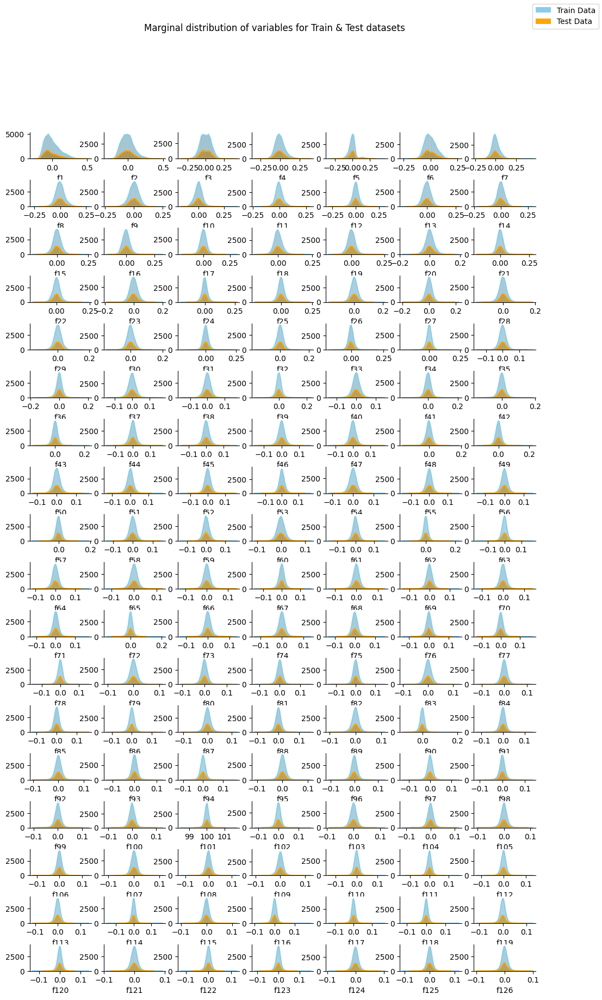

In [93]:

def plot_marginals(X_train, X_test, ncols = 7 ):
    # Determine the number of columns in 'X_train'
    nrows = X_train.shape[1]//ncols

    # Set the figure size and layout
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(12, 20))
    plt.subplots_adjust(hspace=0.8)  # Adjust the vertical spacing between subplots

    # Create a single legend for train and test data
    handles = [
        Patch(facecolor='skyblue', label='Train Data'),
        Patch(facecolor='orange', label='Test Data')
    ]
    fig.legend(handles=handles, loc='upper right')
    
    # Iterate over each column and plot the histogram for train and test data
    for i, ax in enumerate(axes.flatten()):
        sns.histplot(X_train.iloc[:, i], ax=ax, kde=True, color='skyblue')
        sns.histplot(X_test.iloc[:, i], ax=ax, kde=True, color='orange')
        ax.set_xlabel(f'f{i+1}')  # Set the x-label for each subplot
        ax.set_ylabel('')  # Remove the y-label
        
        # Remove spines (borders) around the plot
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)

    fig.suptitle("Marginal distribution of variables for Train & Test datasets", fontsize=12)
     
    plt.show()

cm = sns.light_palette("red", as_cmap=True)

plot_marginals(X_train_0, X_test_0)

We can observe that almost all of the variables $X_i$ are Normally distributed with a mean $\mu_i$ and variance $\sigma_i$.

In [10]:
X_train_0.describe().T.style.background_gradient(subset=['std'], cmap='Reds').background_gradient(subset=['mean'], cmap='Blues')


,count,mean,std,min,25%,50%,75%,max
f0,241483.000000,0.000000,0.107300,-0.282818,-0.081100,-0.020573,0.064290,0.478981
f1,241483.000000,0.000000,0.089867,-0.299667,-0.065712,-0.006715,0.053827,0.455026
f2,241483.000000,-0.000000,0.071092,-0.304787,-0.051291,-0.000378,0.051171,0.353534
f3,241483.000000,-0.000000,0.063595,-0.287942,-0.042966,-0.006150,0.035468,0.390308
f4,241483.000000,-0.000000,0.056167,-0.340842,-0.028946,-0.001736,0.021641,0.459381
f5,241483.000000,-0.000000,0.052904,-0.259085,-0.038267,-0.004972,0.034165,0.262438
f6,241483.000000,-0.000000,0.048377,-0.231023,-0.030271,-0.004074,0.026959,0.449142
f7,241483.000000,-0.000000,0.044899,-0.267998,-0.028679,-0.002053,0.025921,0.275571
f8,241483.000000,0.000000,0.042163,-0.236863,-0.026375,0.001491,0.027867,0.250631
f9,241483.000000,-0.000000,0.040659,-0.178814,-0.024486,-0.000291,0.023221,0.377420


In [13]:
X_test_0.describe().T.style.background_gradient(subset=['std'], cmap='Reds').background_gradient(subset=['mean'], cmap='Blues')

,count,mean,std,min,25%,50%,75%,max
f0,44738.000000,-0.007447,0.105063,-0.245169,-0.086111,-0.031400,0.055125,0.525338
f1,44738.000000,0.004714,0.089226,-0.246973,-0.059426,-0.001845,0.058135,0.495484
f2,44738.000000,0.000817,0.071591,-0.342901,-0.051346,0.000126,0.053036,0.422739
f3,44738.000000,-0.001846,0.062702,-0.326951,-0.044505,-0.005958,0.035062,0.390308
f4,44738.000000,-0.003489,0.050163,-0.289357,-0.029123,-0.003275,0.019424,0.341651
f5,44738.000000,-0.001722,0.054031,-0.190282,-0.040328,-0.007384,0.033177,0.256266
f6,44738.000000,-0.003433,0.046564,-0.228034,-0.031503,-0.004681,0.023733,0.295434
f7,44738.000000,0.000096,0.045538,-0.209031,-0.029481,-0.001589,0.026852,0.214610
f8,44738.000000,-0.002586,0.040397,-0.233266,-0.028445,-0.001014,0.024350,0.187479
f9,44738.000000,-0.001522,0.041124,-0.171620,-0.026283,-0.001567,0.023392,0.247816


We can notice that for both the training and the test set, All variables $X_i$ have a mean $\mu_i=0$ except for $X_{100}$ which has a mean = 100. We can also notice that the standard deviation varies from one variable to another, and ranges from $0.01$ to $0.1$.

In [22]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Correlation matrix for training and test data
corr_train = X_train_0.corr()
corr_test = X_test_0.corr()

fig = make_subplots(rows=1, cols=2, subplot_titles=("Training Data", "Test Data"))

fig.add_trace(go.Heatmap(z=corr_train.values,
                         x=corr_train.columns,
                         y=corr_train.columns,
                         colorscale="Viridis"),
              row=1, col=1)

fig.add_trace(go.Heatmap(z=corr_test.values,
                         x=corr_test.columns,
                         y=corr_test.columns,
                         colorscale="Viridis",
                         showscale=False),
              row=1, col=2)

fig.update_layout(height=600, width=1000, title_text="Correlation Heatmaps")

fig.show()


The correlation matrix is only equal to one on the diagonal, which means that the correlation between all the different feature variable is equal to 0. This means that there is no linear relationship between our feature variables.


We will center  the We can thus make the following suppositions $\forall i \in [1, 128] :$
- $X_i \sim\mathcal N(0,\sigma_i) $
- $X_i \text{ are independent}$

## 2. Modelling
To tackle this problem, we have choose the approach / strategy as well as the model we'll employ. 

### i. Approaches : 
- Flat Multi-class classification : The naive approach to tackle this problem is to consider it a regular multi-class task and only consider the 0th level of categories as our target variable. However this approach doesn't take into account the hierachal structure between the categories. Suppose we have an item whose true categorie is `Mesh Gym Shorts` and we have two models, model A categorizes it as `Workout Shorts`, and model B categorizes it as `Fedora Hats`. In this context model A is better since `Workout Shorts` and  `Mesh Gym Shorts` belong to the same parent node in the category tree. However we can't quantify this with the approach we just mentionned. 

- Big-Bang global classifier : In this approach we create a single (global) model which considers the entire class hierarchy as a whole during training. To do this.  
  
- Hierarchically-Structured Local Classifiers : The idea here is to train multiple "local" models. Either by Node (N-Binary classifiers) or by parent node, or by parent. Each sub strategy has its own distinc pros and cons, but this method is computationally intensive and won't be applicable dupending on the base model architecture we'll use. 

There are of course more advances approaches and strategies for Hierarchal classification. Here are a list of interesting papers :
- [A Top-down Supervised Learning Approach to
Hierarchical Multi-label Classification in
Networks](https://arxiv.org/pdf/2203.12569.pdf)
- [Coherent Hierarchical Multi-Labelv
Classification Networks](https://arxiv.org/pdf/2010.10151.pdf)
- [Hierarchical Multi-label Text Classification with Horizontal and Vertical
Category Correlations]()
- [Hierarchical Multi-label Classification using Fully Associative Ensemble
Learning](https://www.uh.edu/cbl/_files/publications/PR-2017-LZ.pdf)
- [Hierarchical Multi-Label Classification Networks
](https://proceedings.mlr.press/v80/wehrmann18a/wehrmann18a.pdf)

### ii. Models :
Current SOTA models for tabular data are tree based (XGBOOST, LGBM, and Catboost), and deep learning models are still not able to outperform them in the majority of the datasets provided in literature. This is mostly due to the fact that deep learning models are more affected by non-informative features. [Why do tree-based models still outperform deep learning on tabular data?](https://arxiv.org/abs/2207.08815)

### iii. Baseline :

We'll use the pycaret library which contains several SOTA models for classification in order to give a premilinary idea on which models might be useful for our usecase, we'll then establish a baseline for each strategy, and use that as a reference to compare against other strategies and models.



In [3]:
from pycaret.classification import *
s = setup(X_train_raw.drop(columns=["product_id"]), target = 'category_id', session_id = 123, preprocess=False, fold=2, use_gpu=True)

[LightGBM] [Fatal] GPU Tree Learner was not enabled in this build.
Please recompile with CMake option -DUSE_GPU=1
[LightGBM] [Fatal] CUDA Tree Learner was not enabled in this build.
Please recompile with CMake option -DUSE_CUDA=1
[LightGBM] [Fatal] GPU Tree Learner was not enabled in this build.
Please recompile with CMake option -DUSE_GPU=1
[LightGBM] [Fatal] CUDA Tree Learner was not enabled in this build.
Please recompile with CMake option -DUSE_CUDA=1
[LightGBM] [Fatal] GPU Tree Learner was not enabled in this build.
Please recompile with CMake option -DUSE_GPU=1
[LightGBM] [Fatal] CUDA Tree Learner was not enabled in this build.
Please recompile with CMake option -DUSE_CUDA=1
[LightGBM] [Fatal] GPU Tree Learner was not enabled in this build.
Please recompile with CMake option -DUSE_GPU=1
[LightGBM] [Fatal] CUDA Tree Learner was not enabled in this build.
Please recompile with CMake option -DUSE_CUDA=1
[LightGBM] [Fatal] GPU Tree Learner was not enabled in this build.
Please recomp

,Description,Value
0,Session id,123
1,Target,category_id
2,Target type,Multiclass
3,Original data shape,"(241483, 129)"
4,Transformed data shape,"(241483, 129)"
5,Transformed train set shape,"(169038, 129)"
6,Transformed test set shape,"(72445, 129)"
7,Numeric features,128


[LightGBM] [Fatal] GPU Tree Learner was not enabled in this build.
Please recompile with CMake option -DUSE_GPU=1
[LightGBM] [Fatal] CUDA Tree Learner was not enabled in this build.
Please recompile with CMake option -DUSE_CUDA=1
[LightGBM] [Fatal] GPU Tree Learner was not enabled in this build.
Please recompile with CMake option -DUSE_GPU=1
[LightGBM] [Fatal] CUDA Tree Learner was not enabled in this build.
Please recompile with CMake option -DUSE_CUDA=1


In [ ]:
best = compare_models()

# Model	Accuracy	AUC	Recall	Prec.	F1	Kappa	MCC	TT (Sec)
# rf	Random Forest Classifier	0.6131	0.9834	0.6131	0.6078	0.6009	0.6074	0.6076	11.8950
# lr	Logistic Regression	0.6054	0.9887	0.6054	0.6097	0.5769	0.5993	0.5999	2.3350
# qda	Quadratic Discriminant Analysis	0.5854	0.9815	0.5854	0.5890	0.5817	0.5794	0.5795	31.7700
# knn	K Neighbors Classifier	0.5796	0.9277	0.5796	0.5753	0.5733	0.5736	0.5738	8.5700
# nb	Naive Bayes	0.5782	0.9639	0.5782	0.5914	0.5778	0.5724	0.5726	20.5800
# ridge	Ridge Classifier	0.5770	0.0000	0.5770	0.5739	0.5233	0.5702	0.5714	0.3450
# dt	Decision Tree Classifier	0.4054	0.6997	0.4054	0.4070	0.4059	0.3970	0.3970	1.3600
# ada	Ada Boost Classifier	0.2713	0.8726	0.2713	0.2556	0.2484	0.2603	0.2609	13.5550
# svm	SVM - Linear Kernel	0.1067	0.0000	0.1067	0.2464	0.0814	0.0981	0.1182	0.4050

Since supposed that our features are independant we can rely for example on Naif Bayes as a baseline model. It's also blazently fast. We can use it for example to implement feature selection or as a baseline for the local classifiers approach.

In [95]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_train_0, X_train_raw["category_id"], test_size=0.2, random_state=42)

# Initialize the Gaussian Naive Bayes classifier
gnb = GaussianNB()

# Train the model
gnb.fit(X_train, y_train)

# Make predictions on the testing set
y_pred = gnb.predict(X_test)

# Print the accuracy
print("Accuracy: ", metrics.accuracy_score(y_test, y_pred))

Accuracy:  0.5843013023583246


We can also use bagging to aggregate the output of several models.

In [41]:
# Using
N_FOLD=10

def train_nb(X_train, y_train, X_test):
    nfold = N_FOLD
    skf = KFold(n_splits=nfold, shuffle=True, random_state=2019)
    
    progress_bar = Progress(
        TextColumn('[progress.percentage]{task.percentage:>3.0f}%'),
        BarColumn(),
        MofNCompleteColumn(),
        TextColumn('•'),
        TimeElapsedColumn(),
        TextColumn('•'),
        TimeRemainingColumn(),
    )

    oof = np.zeros(len(X_train))
    predictions = np.zeros(len(X_train))
    final_predictions = np.zeros(len(X_test))

    predictors = X_train.columns.values.tolist()

    i = 1

    with progress_bar as progress:
        task1 = progress.add_task('[red]Training XGB', total=nfold)
        while not progress.finished:

            for train_index, valid_index in skf.split(X_train, y_train.values):


                gnb = GaussianNB()
                # print("\nFold {}".format(i))
                
                x = X_train.iloc[train_index][predictors].values
                y = y_train.iloc[train_index].values

                X_train.iloc[valid_index][predictors].values
                y_train.iloc[valid_index].values

                clf = gnb.fit(x, y)


                
                oof[valid_index] = clf.predict(X_train.iloc[valid_index][predictors].values)

                predictions += clf.predict(X_train[predictors].values) / nfold
                final_predictions += clf.predict(X_test[predictors].values) / nfold

                i = i + 1
                progress.update(task1, advance=1)
                time.sleep(0.5)
    f1 = fbeta_score(y_train.values, oof, beta=1, average = 'macro')

    console.print(
        f'f1 = {f1:<0.4f} | CV ={N_FOLD}'
    )
    return final_predictions, predictions, f1


In [42]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
le.fit(X_train_raw["category_id"].values)

n=len(X_train_0)
sub = int(n*0.8)
X_train= pd.DataFrame(X_train_0[:sub])#X_train_raw[:sub]
X_test = pd.DataFrame(X_train_0[sub:]) #X_train_raw[sub:]

y_train = X_train_raw["category_id"][:sub]
y_train = pd.Series(le.transform(y_train.values))

train_nb(X_train, y_train, X_test) 

Output()

f1 = 0.5788 | CV =10

(array([15. ,  5. , 47. , ..., 99. , 71.7, 95. ]),
 array([ 9., 70., 95., ..., 42., 69., 42.]),
 0.5787901777874638)

## 3. Implementation of Big Bang Classifier.
We'll implement a feed forward MLP model as our global classifier, we'll use pytorch lightning to construct our training pipeline.

In [ ]:
!python3 -m train.py -c config.yaml --exp-dir="runs/big-bang"

In [2]:
%load_ext tensorboard
%tensorboard --logdir runs


Launching TensorBoard...

## Conclusion
This was quite an interesting and challenging usecase. There is an open sea of research papers / ideas to implement and test. As well as a cocktail of models with their computational costs restrictions / complexity of implementation. There are a lot of improvement that can be done for this task and this notebook can be considered a preliminry exploration of possible solutions.